In [41]:
import os
import glob
import io
import imageio.v2 as imageio
from datetime import datetime
from PIL import Image as PILImage
import numpy as np
from IPython.display import Image, display, Video
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns


In [42]:
# --- HÀM BỔ TRỢ: LẤY THỜI GIAN TỪ TÊN FILE ---
def get_time_from_filename(fname):
    try:
        base = os.path.basename(fname)
        # Giả sử format là analysis_HH_DD_MM.png
        time_part = base.replace('analysis_', '').replace('.png', '')
        h, d, m = map(int, time_part.split('_'))
        return datetime(2011, m, d, h)
    except:
        return None

In [43]:
# --- HÀM 2: XEM GIF TRONG KHOẢNG NHỎ (KHÔNG LƯU FILE) ---
def preview_gif_segment(figures_dir, start_dt, end_dt, fps=2):
    print(f"🔍 Đang tạo GIF xem trước từ {start_dt} đến {end_dt}...")
    
    # 1. Lọc file
    search_path = os.path.join(figures_dir, "analysis_*.png")
    filenames = glob.glob(search_path)
    valid_files = []
    
    for f in filenames:
        t = get_time_from_filename(f)
        if t and start_dt <= t <= end_dt:
            valid_files.append(f)
            
    valid_files.sort(key=lambda f: get_time_from_filename(f))
    
    if not valid_files:
        print("⚠️ Không có ảnh nào trong khoảng thời gian này!")
        return

    # 2. Đọc ảnh vào RAM
    images = []
    # Lấy kích thước chuẩn từ ảnh đầu tiên trong chuỗi tìm được
    first_img = imageio.imread(valid_files[0])
    h, w = first_img.shape[:2]
    
    for fname in valid_files:
        img = imageio.imread(fname)
        # Resize cho đồng bộ (để GIF không bị giật)
        if img.shape[:2] != (h, w):
            pil_img = PILImage.fromarray(img).resize((w, h), PILImage.Resampling.LANCZOS)
            img = np.array(pil_img)
        images.append(img)

    # 3. Tạo GIF trong bộ nhớ đệm (RAM) - KHÔNG LƯU RA Ổ CỨNG
    with io.BytesIO() as gif_buffer:
        imageio.mimsave(gif_buffer, images, format='GIF', fps=fps, loop=0)
        # Hiển thị trực tiếp từ bytes
        print(f"✅ Hiển thị {len(images)} khung hình (Không lưu file).")
        display(Image(data=gif_buffer.getvalue()))

In [44]:
def save_full_video_mp4(figures_dir, output_filename='full_96h_epidemic.mp4', fps=4):
    print(f"🎬 Đang tổng hợp video toàn bộ dữ liệu từ: {figures_dir}")
    
    # 1. Lấy HẾT tất cả file
    search_path = os.path.join(figures_dir, "analysis_*.png")
    filenames = glob.glob(search_path)
    # Sắp xếp thời gian
    filenames.sort(key=lambda f: get_time_from_filename(f) or datetime.min)
    
    if not filenames:
        print("❌ Không tìm thấy ảnh!")
        return

    print(f"   found: {len(filenames)} khung hình")

    # 2. Xử lý kích thước ảnh (QUAN TRỌNG: Phải là số chẵn)
    images = []
    
    # Đọc ảnh đầu tiên
    first_img = imageio.imread(filenames[0])
    h, w = first_img.shape[:2]
    
    # --- FIX LỖI BROKEN PIPE TẠI ĐÂY ---
    # Nếu chiều cao hoặc rộng là số lẻ, trừ đi 1 để thành số chẵn
    if h % 2 != 0: h -= 1
    if w % 2 != 0: w -= 1
    
    print(f"   📏 Kích thước video chuẩn hóa: {w}x{h} (Đã ép về số chẵn)")
    
    for fname in filenames:
        img = imageio.imread(fname)
        
        # Luôn luôn resize về kích thước chẵn đã tính ở trên
        # Kể cả ảnh gốc đúng size nhưng là số lẻ thì vẫn phải resize xuống số chẵn
        if img.shape[:2] != (h, w):
            pil_img = PILImage.fromarray(img).resize((w, h), PILImage.Resampling.LANCZOS)
            img = np.array(pil_img)
        
        images.append(img)
        
    # 3. Lưu file MP4
    try:
        # macro_block_size=None: Bảo FFMPEG không cần check bội số 16
        # Nhưng vì ta đã ép số chẵn ở trên, nên video sẽ an toàn
        imageio.mimsave(output_filename, images, fps=fps, format='FFMPEG', 
                        quality=8, macro_block_size=None) 
        
        print(f"✅ Đã lưu video thành công: {output_filename}")
        # display(Video(output_filename, width=800)) # Bỏ comment nếu muốn hiện luôn
    except Exception as e:
        print(f"❌ Lỗi lưu MP4: {e}")

In [45]:
# --- A. LƯU VIDEO FULL 96H ---
FIGURES_DIR = '../figures'
full_output_path = os.path.join(FIGURES_DIR, 'Vastopolis_Epidemic_Full_96h.mp4')
save_full_video_mp4(
    figures_dir=FIGURES_DIR, 
    output_filename=full_output_path, 
    fps=2  # Tốc độ nhanh hơn vì video dài
)

🎬 Đang tổng hợp video toàn bộ dữ liệu từ: ../figures
   found: 96 khung hình
   📏 Kích thước video chuẩn hóa: 1590x608 (Đã ép về số chẵn)
✅ Đã lưu video thành công: ../figures\Vastopolis_Epidemic_Full_96h.mp4


🔍 Đang tạo GIF xem trước từ 2011-05-12 00:00:00 đến 2011-05-12 23:00:00...
✅ Hiển thị 24 khung hình (Không lưu file).


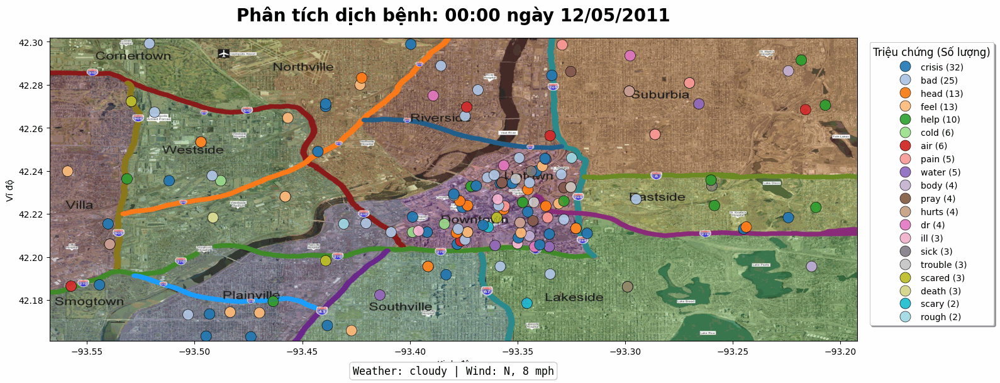

In [46]:
# --- B. XEM NHANH (PREVIEW) ---
# Chỉnh sửa thời gian bạn muốn soi ở đây
start_watch = datetime(2011, 5, 12, 00) # Từ 12h trưa ngày 15
end_watch   = datetime(2011, 5, 12, 23) # Đến 12h trưa ngày 16

preview_gif_segment(
    figures_dir=FIGURES_DIR,
    start_dt=start_watch,
    end_dt=end_watch,
    fps=2 # Tốc độ chậm để soi kỹ
)

In [47]:
# --- CẤU HÌNH ---
DATA_DIR = '../processed'
FIGURES_DIR = '../figures'

def analyze_top_keywords(day, hour=None, save=False):
    """
    Vẽ biểu đồ Top từ khóa.
    - Nếu có hour: Vẽ cho giờ cụ thể.
    - Nếu hour=None: Cộng dồn vẽ cho TOÀN BỘ ngày.
    """
    
    # 1. Chuẩn hóa ngày
    d_str = f"{int(day):02d}"
    
    # 2. Xác định mẫu tìm kiếm file
    if hour is not None:
        # Chế độ xem theo giờ
        h_str = f"{int(hour):02d}"
        search_pattern = os.path.join(DATA_DIR, f"stat_hourly_{h_str}_{d_str}_*.csv")
        mode = "hourly"
    else:
        # Chế độ xem cả ngày (dấu * ở chỗ giờ để lấy tất cả giờ)
        search_pattern = os.path.join(DATA_DIR, f"stat_hourly_*_{d_str}_*.csv")
        mode = "daily"

    found_files = glob.glob(search_pattern)
    
    if not found_files:
        print(f"❌ Không tìm thấy dữ liệu cho ngày {d_str} (Pattern: {search_pattern})")
        return

    # Lấy tháng từ file đầu tiên tìm được để hiển thị
    try:
        # stat_hourly_HH_DD_MM.csv -> lấy phần MM
        m_str = os.path.basename(found_files[0]).replace('.csv', '').split('_')[3]
    except:
        m_str = "??"

    print(f"✅ Đang xử lý {len(found_files)} file dữ liệu cho ngày {d_str}/{m_str}...")

    # 3. Đọc và Tổng hợp dữ liệu
    try:
        # Đọc tất cả các file tìm được vào 1 list
        all_dfs = [pd.read_csv(f) for f in found_files]
        
        if not all_dfs:
            print("⚠️ Các file tìm thấy đều rỗng.")
            return
            
        # Gộp lại thành 1 bảng lớn
        full_df = pd.concat(all_dfs, ignore_index=True)
        
        # --- BƯỚC QUAN TRỌNG: GOM NHÓM VÀ TÍNH TỔNG ---
        # Nếu xem cả ngày, phải cộng dồn số lượng của các giờ lại
        # Nếu xem 1 giờ, lệnh này vẫn chạy đúng (cộng chính nó)
        df_agg = full_df.groupby('keyword', as_index=False)['count'].sum()
        
        # Sắp xếp giảm dần và lấy Top 15
        df_sorted = df_agg.sort_values('count', ascending=False).head(15)
        
        if df_sorted.empty:
            print("⚠️ Bảng dữ liệu rỗng sau khi xử lý.")
            return

    except Exception as e:
        print(f"❌ Lỗi xử lý dữ liệu: {e}")
        return

    # 4. Vẽ biểu đồ
    plt.figure(figsize=(10, 6))
    sns.barplot(data=df_sorted, x='count', y='keyword', palette='viridis')
    
    # Tạo tiêu đề động
    if mode == "hourly":
        title = f"Top Từ khóa lúc {h_str}:00 ngày {d_str}/{m_str}"
        save_name = f"top_kw_{h_str}h_{d_str}_{m_str}.png"
    else:
        title = f"Top Từ khóa TOÀN BỘ ngày {d_str}/{m_str} (Tổng hợp 24h)"
        save_name = f"top_kw_fullday_{d_str}_{m_str}.png"

    plt.title(title, fontsize=16, fontweight='bold')
    plt.xlabel("Tổng số lượng bài đăng", fontsize=12)
    plt.ylabel("Từ khóa", fontsize=12)
    plt.grid(axis='x', linestyle='--', alpha=0.5)
    plt.tight_layout()

    # 5. Lưu ảnh
    if save:
        if not os.path.exists(FIGURES_DIR):
            os.makedirs(FIGURES_DIR)
        
        save_path = os.path.join(FIGURES_DIR, save_name)
        plt.savefig(save_path, bbox_inches='tight')
        print(f"💾 Đã lưu ảnh tại: {save_path}")
    
    plt.show()



✅ Đang xử lý 24 file dữ liệu cho ngày 13/13...


C:\Users\admin\AppData\Local\Temp\ipykernel_12276\3375335836.py:71: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=df_sorted, x='count', y='keyword', palette='viridis')


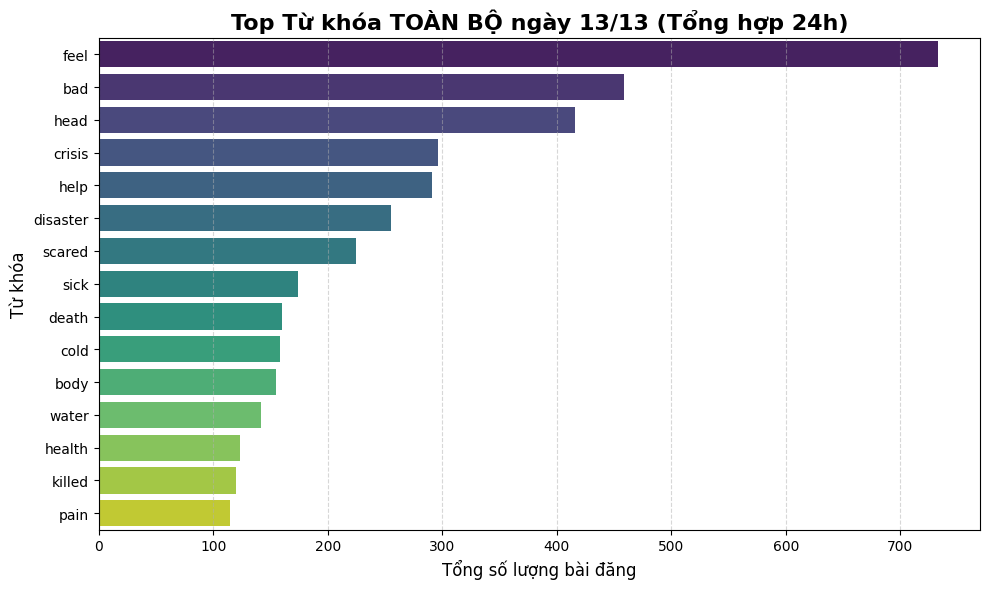

In [53]:
# --- VÍ DỤ CÁCH DÙNG ---

# 1. Xem TOÀN BỘ ngày 13 (Không điền giờ)
analyze_top_keywords(day=13, save=False)

# 2. Xem CỤ THỂ lúc 15h ngày 13
# analyze_top_keywords(day=13, hour=15, save=True)

In [49]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
from sklearn.feature_extraction.text import CountVectorizer

# --- CẤU HÌNH ---
DATA_FILE = '../processed/microblogs_clean.csv'
FIGURES_DIR = '../figures'

# Danh sách từ cần LOẠI BỎ (Stopwords + Triệu chứng đã biết)
# Mục đích: Chỉ muốn nhìn thấy sự kiện, không muốn nhìn thấy bệnh nữa
IGNORE_WORDS = [
    # Tiếng Anh cơ bản (Stopwords)
    "the", "to", "and", "a", "of", "in", "is", "it", "for", "you", "my", "on", "that", 
    "at", "this", "me", "im", "so", "have", "be", "just", "with", "do", "was", "are", 
    "not", "can", "but", "up", "out", "what", "now", "get", "go", "if", "all", "about",
    "like", "from", "we", "dont", "your", "has", "one", "know", "how", "when", "there",
    
    # Triệu chứng (Loại bỏ để nhìn rõ sự kiện khác)
    "flu", "fever", "head", "body", "cold", "sick", "pain", "hurt", "ache", "cough",
    "stomach", "breathe", "throat", "doctor", "hospital", "medicine", "pill", "nurse",
    "feel", "feeling", "bad", "worse", "better", "ill", "tired", "weak", "die", "dying"
]

def analyze_events_and_topics(day, hour=None, ngram_range=(2, 2), top_n=15, save=False):
    """
    Tìm kiếm sự kiện bằng cách đếm cụm từ (N-grams) phổ biến nhất,
    sau khi đã loại bỏ stopwords và triệu chứng bệnh.
    
    - ngram_range=(2, 2): Tìm cụm 2 từ (VD: 'car crash').
    - ngram_range=(1, 1): Tìm từ đơn (VD: 'fire', 'crash').
    """
    
    if not os.path.exists(DATA_FILE):
        print(f"❌ Không tìm thấy file {DATA_FILE}")
        return

    print(f"🔄 Đang quét tìm sự kiện trong ngày {day}/05...")

    # 1. Đọc và lọc dữ liệu
    try:
        df = pd.read_csv(DATA_FILE, usecols=['timestamp', 'text_clean'])
        df['timestamp'] = pd.to_datetime(df['timestamp'])
        
        # Lọc ngày
        subset = df[ (df['timestamp'].dt.day == int(day)) & (df['timestamp'].dt.month == 5) ]
        
        mode_label = f"Ngày {day}/05"
        save_suffix = f"events_day_{day}"

        # Lọc giờ (nếu có)
        if hour is not None:
            subset = subset[subset['timestamp'].dt.hour == int(hour)]
            mode_label = f"{int(hour)}h00 ngày {day}/05"
            save_suffix = f"events_{int(hour)}h_{day}"
            
        if subset.empty:
            print("⚠️ Không có dữ liệu.")
            return

    except Exception as e:
        print(f"❌ Lỗi: {e}")
        return

    # 2. Xử lý văn bản & Đếm cụm từ (Dùng thư viện sklearn cho nhanh và chuẩn)
    # CountVectorizer giúp đếm tần suất từ/cụm từ cực nhanh
    vectorizer = CountVectorizer(
        stop_words=IGNORE_WORDS,  # Loại bỏ từ rác & từ bệnh
        ngram_range=ngram_range,  # (2, 2) nghĩa là chỉ lấy cụm 2 từ
        max_features=1000         # Chỉ xét 1000 cụm phổ biến nhất để đỡ nặng máy
    )
    
    # Xử lý cột text (chuyển về string trước để tránh lỗi)
    text_data = subset['text_clean'].dropna().astype(str).tolist()
    
    if not text_data:
        print("⚠️ Không có nội dung text.")
        return

    try:
        X = vectorizer.fit_transform(text_data)
        
        # Tổng hợp kết quả
        counts = X.sum(axis=0).A1
        words = vectorizer.get_feature_names_out()
        
        # Tạo DataFrame kết quả
        freq_df = pd.DataFrame({'phrase': words, 'count': counts})
        freq_df = freq_df.sort_values('count', ascending=False).head(top_n)
        
    except ValueError:
        print("⚠️ Không tìm thấy cụm từ nào hợp lệ (có thể do lọc hết từ rồi).")
        return

    # 3. Vẽ biểu đồ
    plt.figure(figsize=(12, 6))
    sns.barplot(data=freq_df, x='count', y='phrase', palette='rocket')
    
    plt.title(f"Top Sự kiện/Chủ đề: {mode_label}", fontsize=16, fontweight='bold')
    plt.xlabel("Số lần nhắc đến", fontsize=12)
    plt.ylabel("Cụm từ (Phrase)", fontsize=12)
    plt.grid(axis='x', linestyle='--', alpha=0.5)
    plt.tight_layout()

    # 4. Lưu ảnh
    if save:
        if not os.path.exists(FIGURES_DIR): os.makedirs(FIGURES_DIR)
        save_path = os.path.join(FIGURES_DIR, f"topic_{save_suffix}.png")
        plt.savefig(save_path, bbox_inches='tight')
        print(f"💾 Đã lưu ảnh: {save_path}")
    
    plt.show()



🔄 Đang quét tìm sự kiện trong ngày 15/05...


C:\Users\admin\AppData\Local\Temp\ipykernel_12276\2702273789.py:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=freq_df, x='count', y='phrase', palette='rocket')


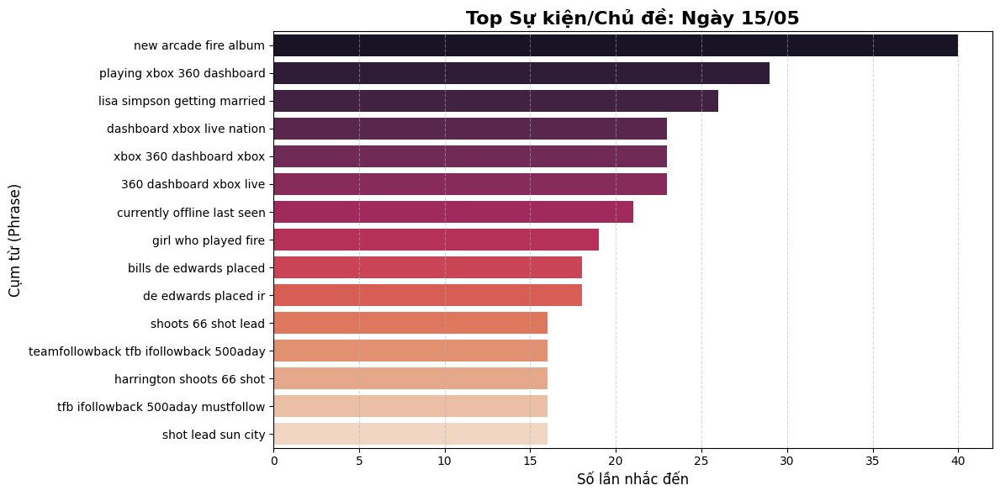

In [50]:
# --- VÍ DỤ SỬ DỤNG ---

# 1. Tìm cụm 2 từ (Bigrams) để đoán sự kiện (VD: "gas leak", "car accident")
# Thử ngày 17/05 (Ví dụ ngày có thể có sự kiện)
analyze_events_and_topics(day=15, ngram_range=(4, 4), save=False)

# 2. Hoặc tìm từ đơn (1 từ) nhưng loại bỏ hết từ bệnh
# analyze_events_and_topics(day=17, ngram_range=(1, 1), save=True)

🔍 Đang tạo GIF xem trước từ 2011-05-15 00:00:00 đến 2011-05-15 23:00:00...
✅ Hiển thị 24 khung hình (Không lưu file).


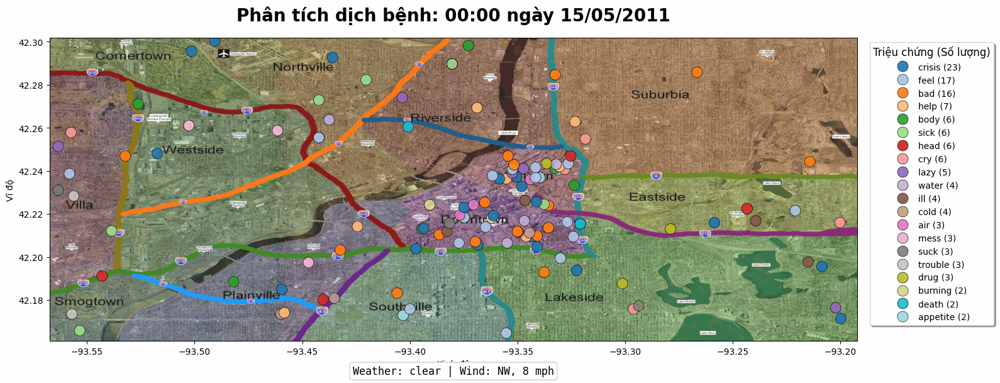

✅ Đang xử lý 24 file dữ liệu cho ngày 15/15...


C:\Users\admin\AppData\Local\Temp\ipykernel_12276\3375335836.py:71: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=df_sorted, x='count', y='keyword', palette='viridis')


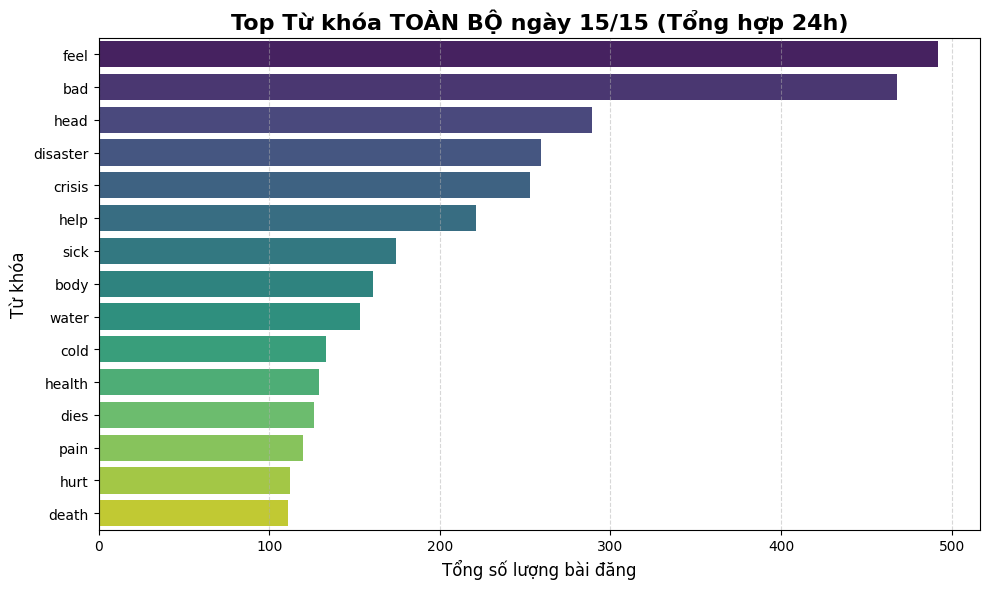

🔄 Đang quét tìm sự kiện trong ngày 15/05...


C:\Users\admin\AppData\Local\Temp\ipykernel_12276\2702273789.py:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=freq_df, x='count', y='phrase', palette='rocket')


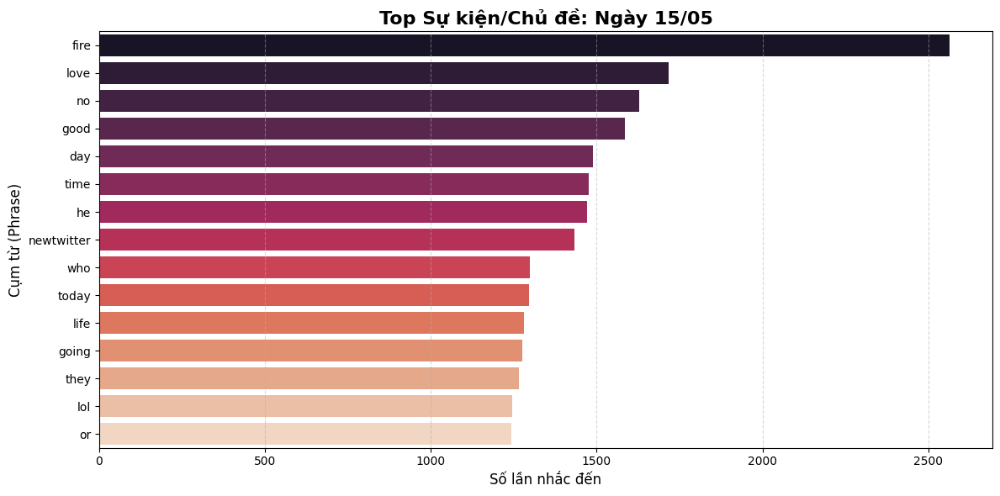

🔄 Đang quét tìm sự kiện trong ngày 15/05...


C:\Users\admin\AppData\Local\Temp\ipykernel_12276\2702273789.py:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=freq_df, x='count', y='phrase', palette='rocket')


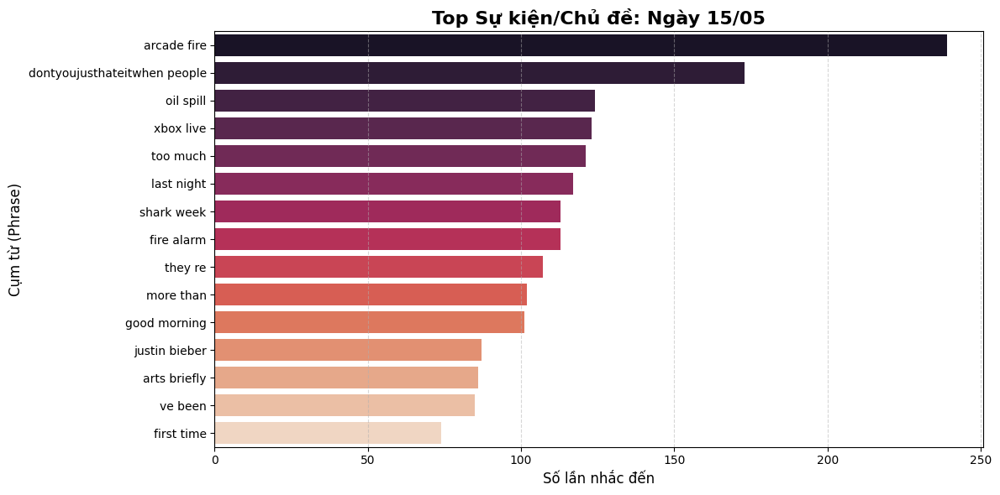

🔄 Đang quét tìm sự kiện trong ngày 15/05...


C:\Users\admin\AppData\Local\Temp\ipykernel_12276\2702273789.py:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=freq_df, x='count', y='phrase', palette='rocket')


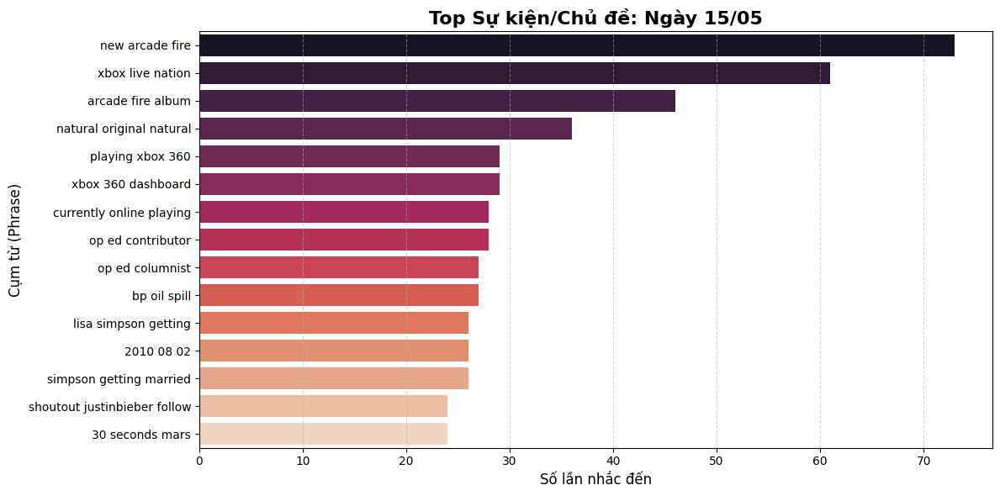

🔄 Đang quét tìm sự kiện trong ngày 15/05...


C:\Users\admin\AppData\Local\Temp\ipykernel_12276\2702273789.py:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=freq_df, x='count', y='phrase', palette='rocket')


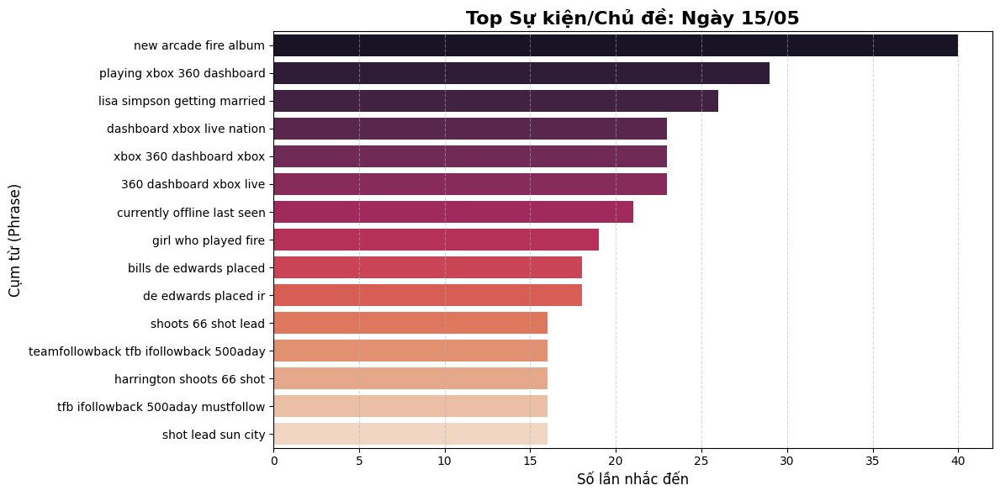

In [65]:
date=15
# --- B. XEM NHANH (PREVIEW) ---
# Chỉnh sửa thời gian bạn muốn soi ở đây
start_watch = datetime(2011, 5, date, 0) # Từ 12h trưa ngày 15
end_watch   = datetime(2011, 5, date, 23) # Đến 12h trưa ngày 16

preview_gif_segment(
    figures_dir=FIGURES_DIR,
    start_dt=start_watch,
    end_dt=end_watch,
    fps=2 # Tốc độ chậm để soi kỹ
)
# --- VÍ DỤ CÁCH DÙNG ---


analyze_top_keywords(day=date, save=False)
analyze_events_and_topics(day=date, ngram_range=(1, 1), save=False)

analyze_events_and_topics(day=date, ngram_range=(2, 2), save=False)
analyze_events_and_topics(day=date, ngram_range=(3, 3), save=False)
analyze_events_and_topics(day=date, ngram_range=(4, 4), save=False)

